---

### Running Julia

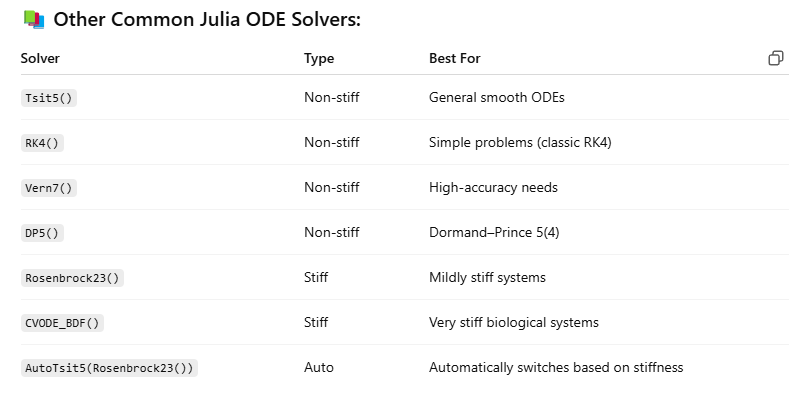

Libraries used in the official Tutorial of Vizuhara:

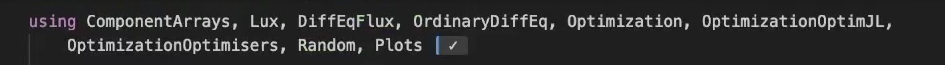

The Langmuir adsorption model is described by the following differential equation:

$$
\frac{dq}{dt} = k_a \cdot C \cdot (Q_m - q) - k_d \cdot q
$$

In [1]:
using DifferentialEquations

# Parameters for synthetic data
ka = 1.0f0
kd = 0.5f0
Qm = 2.0f0
C = 1.0f0

function langmuir_ode!(dq, q, p, t)
    dq[1] = ka * C * (Qm - q[1]) - kd * q[1]
end

q0 = Float32[0.0]
tspan = (0.0f0, 10.0f0)
datasize = 30
tsteps = range(tspan[1], tspan[2], length = datasize)

prob = ODEProblem(langmuir_ode!, q0, tspan)
sol = solve(prob, Tsit5(), saveat=tsteps)

retcode: Success
Interpolation: 1st order linear
t: 30-element Vector{Float32}:
  0.0
  0.3448276
  0.6896552
  1.0344827
  1.3793104
  1.7241379
  2.0689654
  2.413793
  2.7586207
  3.1034484
  ⋮
  7.2413793
  7.586207
  7.9310346
  8.275862
  8.620689
  8.965517
  9.310345
  9.655172
 10.0
u: 30-element Vector{Vector{Float32}}:
 [0.0]
 [0.5384497]
 [0.8594535]
 [1.0508262]
 [1.1649152]
 [1.2329261]
 [1.273473]
 [1.2976555]
 [1.3120551]
 [1.3206562]
 ⋮
 [1.3333086]
 [1.3333124]
 [1.3333215]
 [1.3333302]
 [1.3333338]
 [1.3333322]
 [1.3333282]
 [1.3333284]
 [1.3333305]

In [2]:
ode_data = Array(sol)

1×30 Matrix{Float32}:
 0.0  0.53845  0.859453  1.05083  …  1.33333  1.33333  1.33333  1.33333

In [3]:
length(ode_data)

30

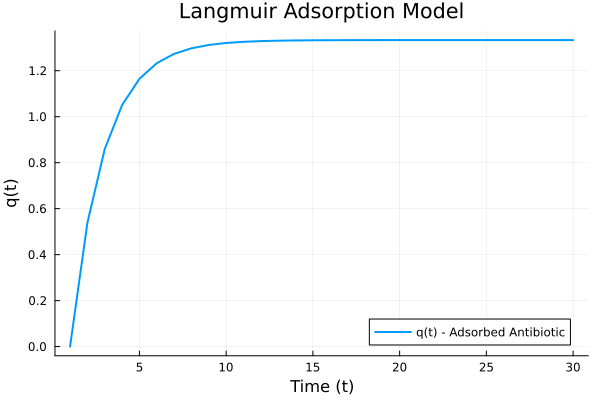

In [4]:
using Plots

plot(ode_data',
     label="q(t) - Adsorbed Antibiotic",
     xlabel="Time (t)",
     ylabel="q(t)",
     title="Langmuir Adsorption Model",
     lw=2,
     legend=:bottomright,
     grid=true)

In [5]:
sol(10)

1-element Vector{Float32}:
 1.3333305

### 🎯 Next Goal: Neural ODE
Train a **Neural ODE** that learns to approximate the behavior of the Langmuir model — based only on the synthetic data we just generated.

In [6]:
using DifferentialEquations, DiffEqFlux, Flux, Plots, Random

In [7]:
# Set up RNG
rng = Random.default_rng()

# Time span and save points
tspan = (0.0f0, 10.0f0)
datasize = 30
tsteps = range(tspan[1], tspan[2], length = datasize)


lux_model = Lux.Chain(
    Lux.Dense(1, 16, tanh),
    Lux.Dense(16, 1)
)

# Initialize parameters and state
ps, st = Lux.setup(rng, lux_model)

# Define ODE function
lux_ode_function = (u, p, t) -> lux_model(u, ps, st)[1] # returns only the model output

#11 (generic function with 1 method)

In [8]:
print("Weights: ", ps.layer_1.weight, "\nBiases:  ", ps.layer_1.bias, "\n")

Weights: Float32[-1.1734185; -2.3640816; -0.24457455; -2.2295299; -0.9488072; 0.27242652; -0.40793777; -1.5703263; -1.3362242; 1.1451894; 1.4042686; -1.8247488; -0.72434133; -2.405918; -0.178362; -0.3262983;;]
Biases:  Float32[-0.7559478, 0.28355086, 0.7940053, 0.5428208, -0.23480809, 0.2506857, -0.8351052, 0.71208346, 0.64428425, -0.8627722, 0.80251646, -0.1300056, 0.40414774, -0.42167246, -0.5707619, 0.33492887]


In [9]:
# Create Neural ODE using the Lux model
neural_ode = NeuralODE(lux_model, tspan, Tsit5(), saveat=tsteps)

NeuralODE(
    model = Chain(
        layer_1 = Dense(1 => 16, tanh),  # 32 parameters
        layer_2 = Dense(16 => 1),       # 17 parameters
    ),
)         # Total: 49 parameters,
          #        plus 0 states.

In [10]:
# Initial condition
y0 = Float32[0.0] # same as q0

# Evaluate the Neural ODE - forward pass  ➜ returns (solution, new_state)
predicted, _ = neural_ode(y0, ps, st)

(ODESolution{Float32, 2, Vector{Vector{Float32}}, Nothing, Nothing, Vector{Float32}, Vector{Vector{Vector{Float32}}}, Nothing, ODEProblem{Vector{Float32}, Tuple{Float32, Float32}, false, @NamedTuple{layer_1::@NamedTuple{weight::Matrix{Float32}, bias::Vector{Float32}}, layer_2::@NamedTuple{weight::Matrix{Float32}, bias::Vector{Float32}}}, ODEFunction{false, SciMLBase.FullSpecialize, DiffEqFlux.var"#dudt#17"{StatefulLuxLayer{Static.True, Lux.Chain{@NamedTuple{layer_1::Lux.Dense{typeof(tanh), Int64, Int64, Nothing, Nothing, Static.True}, layer_2::Lux.Dense{typeof(identity), Int64, Int64, Nothing, Nothing, Static.True}}, Nothing}, Nothing, @NamedTuple{layer_1::@NamedTuple{}, layer_2::@NamedTuple{}}}}, LinearAlgebra.UniformScaling{Bool}, Nothing, typeof(DiffEqFlux.basic_tgrad), Nothing, Nothing, Nothing, Nothing, Nothing, Nothing, Nothing, Nothing, Nothing, typeof(SciMLBase.DEFAULT_OBSERVED), Nothing, Nothing, Nothing, Nothing}, Base.Pairs{Symbol, Union{}, Tuple{}, @NamedTuple{}}, SciMLBase

In [13]:
print(predicted)

ODESolution{Float32, 2, Vector{Vector{Float32}}, Nothing, Nothing, Vector{Float32}, Vector{Vector{Vector{Float32}}}, Nothing, ODEProblem{Vector{Float32}, Tuple{Float32, Float32}, false, @NamedTuple{layer_1::@NamedTuple{weight::Matrix{Float32}, bias::Vector{Float32}}, layer_2::@NamedTuple{weight::Matrix{Float32}, bias::Vector{Float32}}}, ODEFunction{false, SciMLBase.FullSpecialize, DiffEqFlux.var"#dudt#17"{StatefulLuxLayer{Static.True, Lux.Chain{@NamedTuple{layer_1::Lux.Dense{typeof(tanh), Int64, Int64, Nothing, Nothing, Static.True}, layer_2::Lux.Dense{typeof(identity), Int64, Int64, Nothing, Nothing, Static.True}}, Nothing}, Nothing, @NamedTuple{layer_1::@NamedTuple{}, layer_2::@NamedTuple{}}}}, LinearAlgebra.UniformScaling{Bool}, Nothing, typeof(DiffEqFlux.basic_tgrad), Nothing, Nothing, Nothing, Nothing, Nothing, Nothing, Nothing, Nothing, Nothing, typeof(SciMLBase.DEFAULT_OBSERVED), Nothing, Nothing, Nothing, Nothing}, Base.Pairs{Symbol, Union{}, Tuple{}, @NamedTuple{}}, SciMLBase.

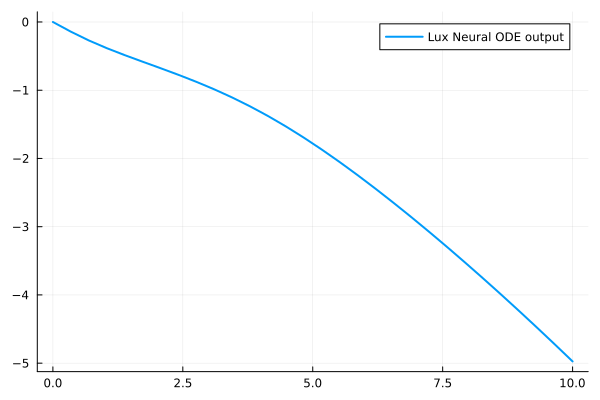

In [44]:
# Plot results
output = hcat(predicted.u...) |> x -> convert(Matrix{Float32}, x)
plot(tsteps, output', label="Lux Neural ODE output", lw=2)

In [15]:
# Prediction Function

function predict_neuralode(ps)
    Array(neural_ode(y0, ps, st)[1])
end

predict_neuralode (generic function with 1 method)

In [16]:
predict_neuralode(ps)

1×30 Matrix{Float32}:
 0.0  -0.141574  -0.269897  -0.382923  …  -4.47551  -4.72318  -4.97459

### 🎯 Next Goal: Creating a training loop based on the loss

In [34]:
using ComponentArrays, Optimization, OptimizationOptimisers, Optim, OptimizationOptimJL

In [18]:
# Calculate Loss: the difference between actual function and the loss function.
function loss_neuralode(p)
    pred = predict_neuralode(p)
    loss = sum(abs2, ode_data .- pred)
    return loss, pred
end

loss_neuralode (generic function with 1 method)

In [19]:
loss_neuralode(ps)

(407.35352f0, Float32[0.0 -0.14157404 … -4.7231803 -4.974589])

In [20]:
callback = function (state, l; doplot = true)
    println("loss = ", l)

    if doplot
        pvec = state.u                     # current parameters (ComponentVector)
        pred = predict_neuralode(pvec)     # forward pass
        plt  = scatter(tsteps, ode_data[1, :]; label = "data")
        scatter!(plt, tsteps, pred[1, :]; label = "prediction")
        display(plt)
    end
    return false                           # return `true` to stop early
end

#17 (generic function with 1 method)

In [21]:
psinit = ComponentArray(ps)
callback(loss_neuralode(psinit)...; doplot = false)

loss = Float32[0.0 -0.14157404 -0.26989707 -0.3829234 -0.48498496 -0.5813478 -0.67645234 -0.7738532 -0.8764248 -0.9865101 -1.1059724 -1.2361127 -1.3776274 -1.5306296 -1.6946794 -1.868938 -2.0523787 -2.2440302 -2.4429839 -2.648422 -2.8597624 -3.0765781 -3.2984955 -3.5252004 -3.7564347 -3.9919882 -4.231722 -4.4755106 -4.7231803 -4.974589]


false

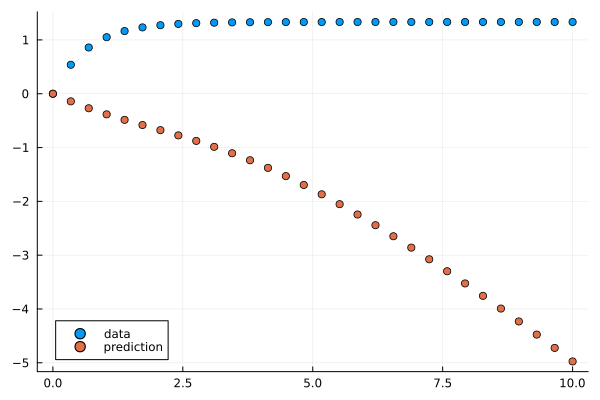

loss = 407.35355
loss = 57.203968
loss = 42.78919
loss = 36.331398
loss = 32.466526
loss = 29.65754
loss = 27.329437
loss = 25.225988
loss = 23.215303
loss = 21.220537
loss = 19.191793
loss = 17.094164
loss = 14.9035
loss = 12.607353
loss = 10.211673
loss = 7.7546253
loss = 5.3288956
loss = 3.1052582
loss = 1.3388011
loss = 0.32638133
loss = 0.28649184
loss = 1.1375566
loss = 2.3102174
loss = 3.0807672
loss = 3.1347222
loss = 2.6006603
loss = 1.7987394
loss = 1.0253149
loss = 0.45404294
loss = 0.13388912
loss = 0.032402277
loss = 0.08254993
loss = 0.2145869
loss = 0.37150615
loss = 0.51337177
loss = 0.61613274
loss = 0.66854227
loss = 0.66893375
loss = 0.62259036
loss = 0.53945935
loss = 0.43259767
loss = 0.3164213
loss = 0.20525053
loss = 0.11170998
loss = 0.045159776
loss = 0.010347232
loss = 0.006607991
loss = 0.027955335
loss = 0.06429481
loss = 0.10367473
loss = 0.13507327
loss = 0.15090606
loss = 0.14850691
loss = 0.12999932
loss = 0.1010287
loss = 0.06866116
loss = 0.039399087
l

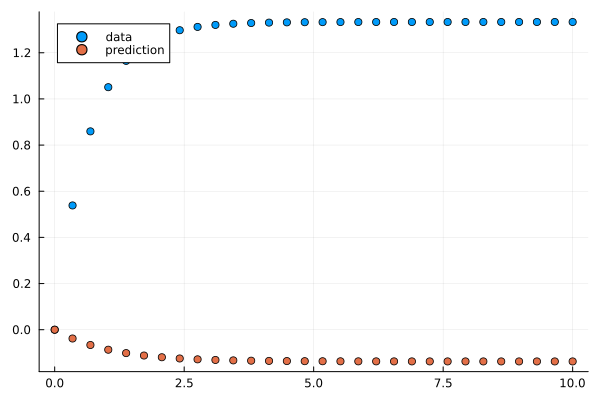

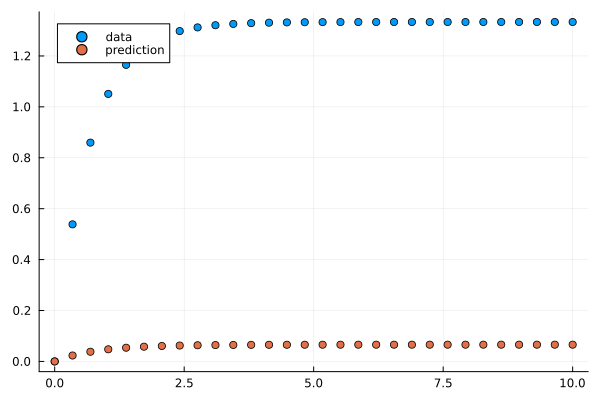

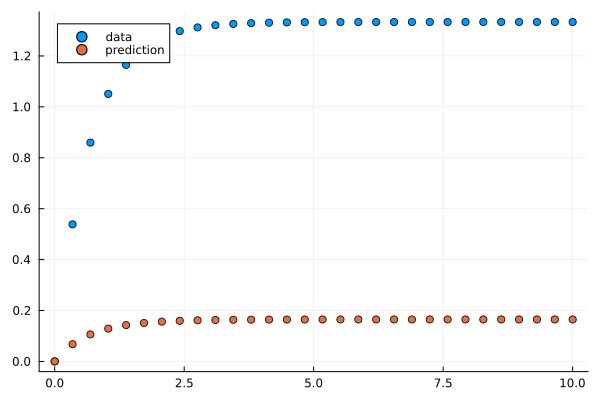

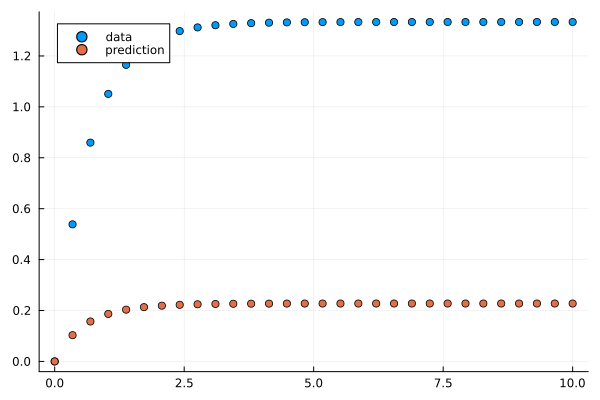

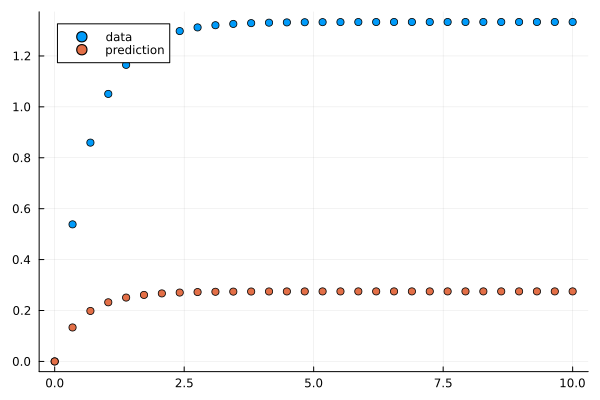

...

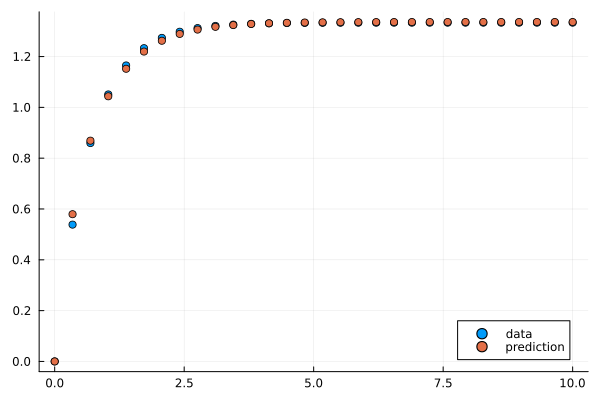

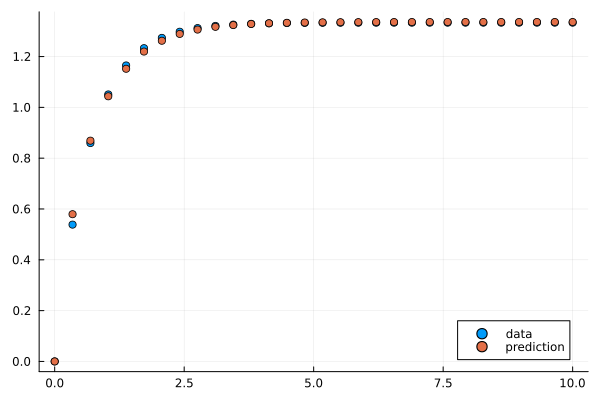

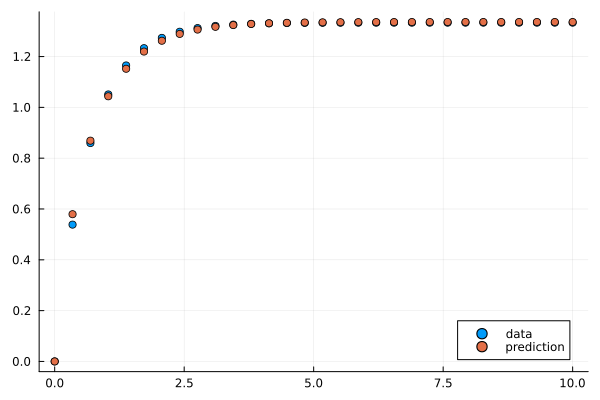

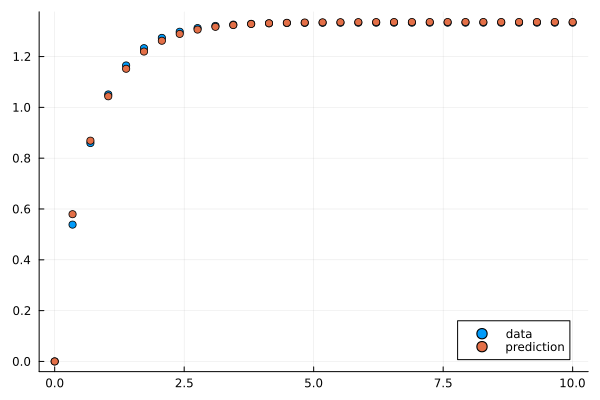

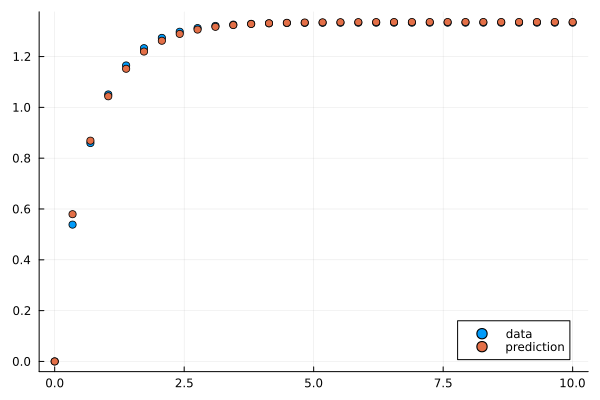

retcode: Default
u: ComponentVector{Float32}(layer_1 = (weight = Float32[-0.8753714; -1.9566419; … ; 0.12647101; -0.046294395;;], bias = Float32[-1.0758444, -0.01824801, 1.236744, 1.008742, -0.5349662, 0.5538466, -2.0547726, 1.7791266, 1.2848324, -0.3094521, 0.42145795, 0.44387844, -0.0056477156, 0.021014562, -0.9520289, 0.1442995]), layer_2 = (weight = Float32[-0.0854178 0.14237133 … -0.6087578 0.24352309], bias = Float32[0.33895218]))

In [22]:
# Use Optimization.jl to solve the problem
adtype = Optimization.AutoZygote()

optf = Optimization.OptimizationFunction((x, p) -> loss_neuralode(x)[1], adtype)
optprob = Optimization.OptimizationProblem(optf, psinit)

result_neuralode = Optimization.solve(optprob, OptimizationOptimisers.Adam(0.05); callback = callback, maxiters = 300)

In [29]:
println("ADAM final loss = ", result_neuralode.objective)

ADAM final loss = 0.0025218525


### ✨ Success!! 
Initial Loss: **407.35355** -> Final loss: **0.0025218525**


### 🎯Let us Finetune! using "BFGS"

Why a second optimiser?

Stage 1: **ADAM** – fast, noisy, good for escaping bad basins.

Stage 2: **BFGS** – deterministic quasi-Newton; once you’re close to
a minimum it can converge with fewer steps and higher precision.

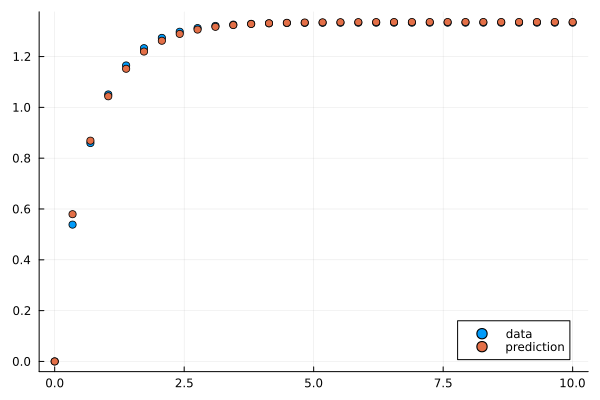

loss = 0.0025218588
loss = 0.002517697
loss = 0.0016856912
loss = 0.00052483636
loss = 0.00016595658
loss = 6.0213402e-5
loss = 5.5859655e-5
loss = 5.1078307e-5
loss = 2.1255879e-5
loss = 1.0514233e-5
loss = 8.242212e-6
loss = 5.3441845e-6
loss = 5.1687916e-6
loss = 5.1683714e-6
loss = 5.167057e-6
loss = 5.165374e-6
loss = 5.164875e-6
loss = 5.163816e-6
loss = 5.163816e-6


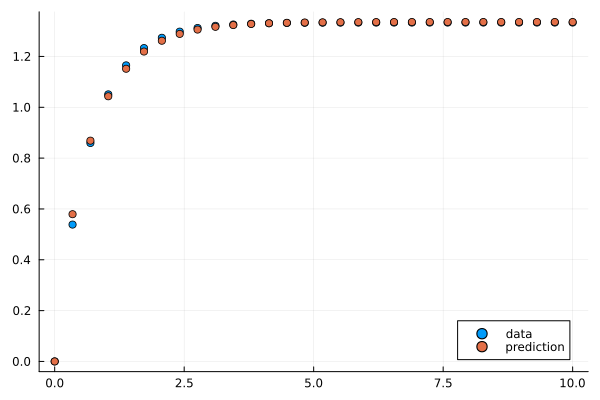

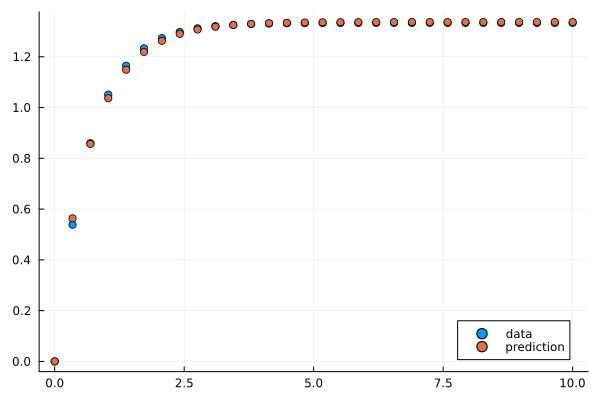

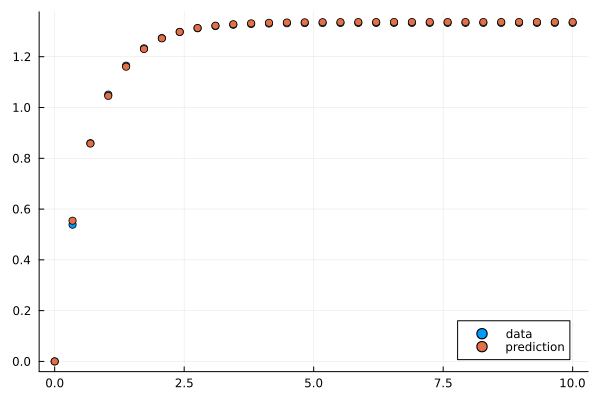

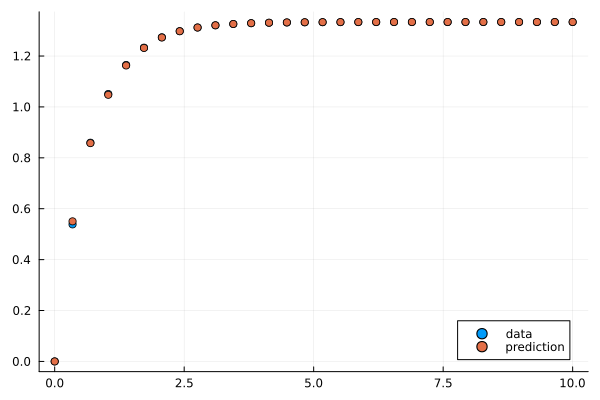

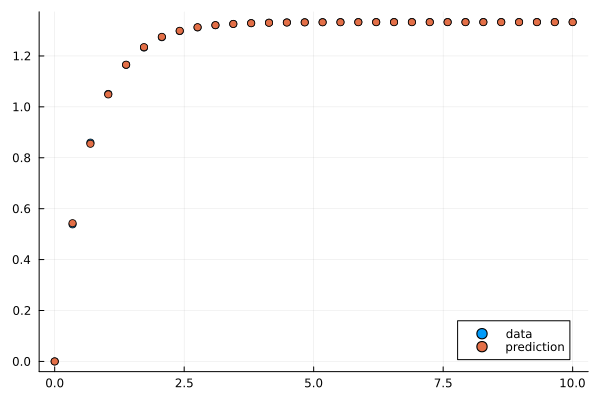

...

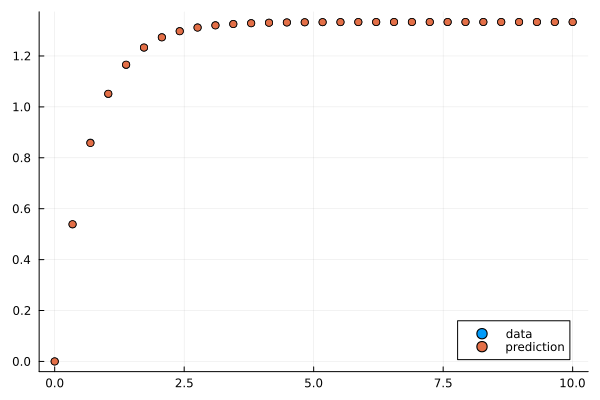

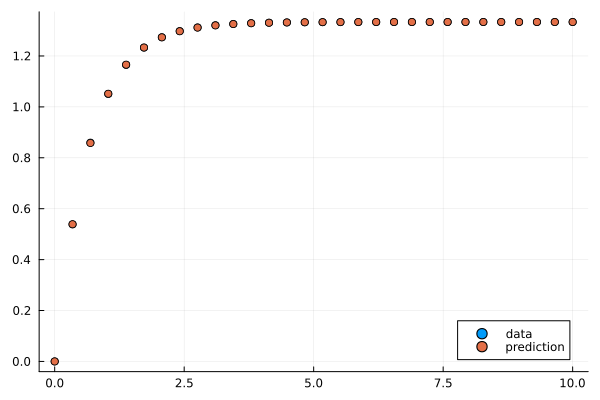

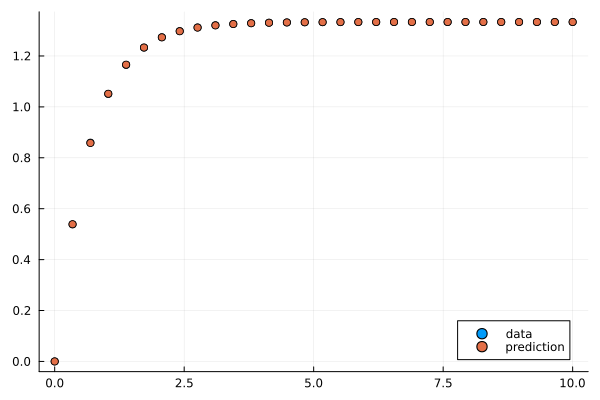

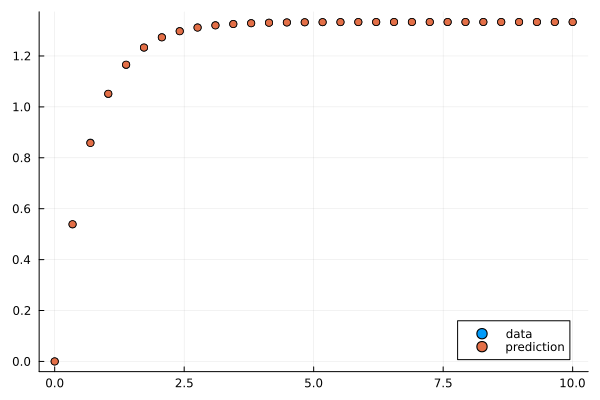

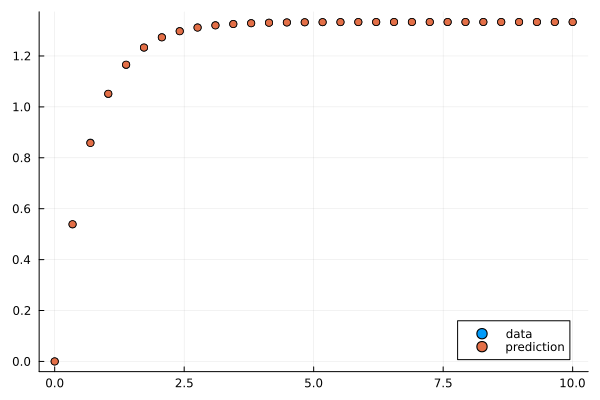

retcode: Success
u: ComponentVector{Float32}(layer_1 = (weight = Float32[-0.876014; -1.9581252; … ; 0.15069489; -0.05775808;;], bias = Float32[-1.0707647, -0.05402785, 1.2059664, 1.043151, -0.54187435, 0.5384775, -2.0499573, 1.7447808, 1.2673167, -0.29682273, 0.48090932, 0.33770505, 0.0012447787, -0.16002965, -0.9255843, 0.122432716]), layer_2 = (weight = Float32[-0.028171096 0.015430332 … -0.53726983 0.22561985], bias = Float32[0.24965292]))

In [43]:
optprob2 = remake(optprob; u0 = result_neuralode.u)
result_neuralode2 = Optimization.solve(optprob2, OptimizationOptimJL.BFGS(; initial_stepnorm = 0.01); callback, allow_f_increases = false)

In [3]:
final_p = result_neuralode2.u

UndefVarError: UndefVarError: `result_neuralode2` not defined in `Main`
Suggestion: check for spelling errors or missing imports.

In [2]:
final_loss, final_pred = loss_neuralode(final_p)

callback(final_p, final_loss; doplot = true)

UndefVarError: UndefVarError: `loss_neuralode` not defined in `Main`
Suggestion: check for spelling errors or missing imports.